# **Scientific Programming with Python - Final Project**

<img src="https://www.lufthansa.com/content/dam/lh/images/local_images/book-&-manage/travel-information/wecare/wecare-illustration-03-on-board.png.transform/lh-dcep-transform-width-1440/img.jpg" width="1500" height="300">

<h1>Airlines Customer satisfaction ✈ </h1>
Dataset source Kaggle site 


https://www.kaggle.com/sjleshrac/airlines-customer-satisfaction 

> **Author's Name** - Tslil Aharon 



# **Intro**


> **Subject**




The theme of my project is airline customer satisfaction.

The data represent the satisfaction data of an anonymous airline called **Invistico Airlines**.


The customers presented in this data are customers who flew with the airline and completed the company satisfaction survey.


The main objective of the project is to analyze and investigate the results of the survey to find out what is the main factor influencing customer satisfaction and how these data can be improved with predicting future customer satisfaction based on the data set.



> **Size of data set**



**Data array characteristics:**

The data set contains 129880 rows 23 columns.


> **Breakdown of features and their types**




The dataset consists

**Features:**



**Categorical - Nominal:**


*   **satisfaction**:  Boolean, satisfied/dissatisfied 
*   **Gender**:  Boolean, Female/Male
*   **Customer Type**:  Boolean, Loyal Customer/disloyal Customer
*   **Type of Travel**:  Boolean, Personal Travel/Business Travel
*   **Class**:  Categorical, Eco/Business/Eco Plus


**Numeric:**


*   **Age**:  Integer, Customer age between 7-80
*   **Flight Distance**:  Integer, distance for flight between 265-4260
*   **Seat comfort**:  Integer, between 0–5
*   **Departure/Arrival time convenient**:  Integer, between 0–5
*   **Food and Drink**:  Integer, between 0–5
*   **Gate location**:  Integer, between 0–5
*   **Inflight wifi service**:  Integer, between 0–5
*   **Inflight entertainment**:  Integer, between 0–5
*   **Online support**:  Integer, between 0–5
*   **Ease of Online booking**:  Integer, between 0–5
*   **On-board service**:  Integer, between 0–5
*   **Leg room service**:  Integer, between 0–5
*   **Baggage handling**:  Integer, between 0–5
*   **Checkin service**:  Integer, between 0–5
*   **Cleanliness**:  Integer, between 0–5
*   **Online boarding**:  Integer, between 0–5
*   **Departure Delay in Minutes**:  Integer
*   **Arrival Delay in Minutes**:  float

##### install/import 

In [ ]:
!pip install numpy
!pip install pandas
!pip install seaborn
!pip install matplotlib
!pip install sklearn
!pip install pydotplus
!pip install scipy

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import pydotplus
import matplotlib.pyplot as plt
from matplotlib import ticker
from pandas.api.types import CategoricalDtype
from sklearn import metrics
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import accuracy_score,confusion_matrix,classification_report
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier

In [ ]:
from google.colab import drive
drive.mount('/gdrive')

Drive already mounted at /gdrive; to attempt to forcibly remount, call drive.mount("/gdrive", force_remount=True).


# **Initial Data Analysis**

In [ ]:
df = pd.read_csv("/gdrive/MyDrive/Colab Notebooks/Invistico_Airline.csv")
df.head()

,satisfaction,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Seat comfort,Departure/Arrival time convenient,Food and drink,Gate location,Inflight wifi service,Inflight entertainment,Online support,Ease of Online booking,On-board service,Leg room service,Baggage handling,Checkin service,Cleanliness,Online boarding,Departure Delay in Minutes,Arrival Delay in Minutes
0,satisfied,Female,Loyal Customer,65,Personal Travel,Eco,265,0,0,0,2,2,4,2,3,3,0,3,5,3,2,0,0.0
1,satisfied,Male,Loyal Customer,47,Personal Travel,Business,2464,0,0,0,3,0,2,2,3,4,4,4,2,3,2,310,305.0
2,satisfied,Female,Loyal Customer,15,Personal Travel,Eco,2138,0,0,0,3,2,0,2,2,3,3,4,4,4,2,0,0.0
3,satisfied,Female,Loyal Customer,60,Personal Travel,Eco,623,0,0,0,3,3,4,3,1,1,0,1,4,1,3,0,0.0
4,satisfied,Female,Loyal Customer,70,Personal Travel,Eco,354,0,0,0,3,4,3,4,2,2,0,2,4,2,5,0,0.0


In [ ]:
df.describe()

,Age,Flight Distance,Seat comfort,Departure/Arrival time convenient,Food and drink,Gate location,Inflight wifi service,Inflight entertainment,Online support,Ease of Online booking,On-board service,Leg room service,Baggage handling,Checkin service,Cleanliness,Online boarding,Departure Delay in Minutes,Arrival Delay in Minutes
count,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129487.000000
mean,39.427957,1981.409055,2.838597,2.990645,2.851994,2.990422,3.249130,3.383477,3.519703,3.472105,3.465075,3.485902,3.695673,3.340807,3.705759,3.352587,14.713713,15.091129
std,15.119360,1027.115606,1.392983,1.527224,1.443729,1.305970,1.318818,1.346059,1.306511,1.305560,1.270836,1.292226,1.156483,1.260582,1.151774,1.298715,38.071126,38.465650
min,7.000000,50.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,27.000000,1359.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,3.000000,2.000000,3.000000,2.000000,3.000000,3.000000,3.000000,2.000000,0.000000,0.000000
50%,40.000000,1925.000000,3.000000,3.000000,3.000000,3.000000,3.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,3.000000,4.000000,4.000000,0.000000,0.000000
75%,51.000000,2544.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,5.000000,5.000000,4.000000,5.000000,5.000000,4.000000,5.000000,4.000000,12.000000,13.000000
max,85.000000,6951.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,1592.000000,1584.000000


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 129880 entries, 0 to 129879
Data columns (total 23 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   satisfaction                       129880 non-null  object 
 1   Gender                             129880 non-null  object 
 2   Customer Type                      129880 non-null  object 
 3   Age                                129880 non-null  int64  
 4   Type of Travel                     129880 non-null  object 
 5   Class                              129880 non-null  object 
 6   Flight Distance                    129880 non-null  int64  
 7   Seat comfort                       129880 non-null  int64  
 8   Departure/Arrival time convenient  129880 non-null  int64  
 9   Food and drink                     129880 non-null  int64  
 10  Gate location                      129880 non-null  int64  
 11  Inflight wifi service              1298

In [ ]:
df.isnull().sum() 

satisfaction                           0
Gender                                 0
Customer Type                          0
Age                                    0
Type of Travel                         0
Class                                  0
Flight Distance                        0
Seat comfort                           0
Departure/Arrival time convenient      0
Food and drink                         0
Gate location                          0
Inflight wifi service                  0
Inflight entertainment                 0
Online support                         0
Ease of Online booking                 0
On-board service                       0
Leg room service                       0
Baggage handling                       0
Checkin service                        0
Cleanliness                            0
Online boarding                        0
Departure Delay in Minutes             0
Arrival Delay in Minutes             393
dtype: int64

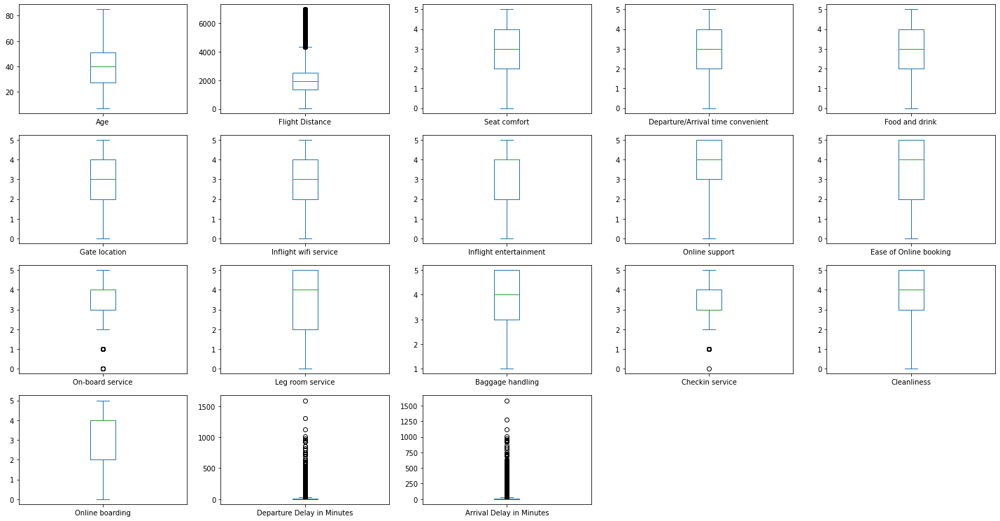

In [ ]:
df.plot(kind='box', subplots=True, layout=(6,5), figsize=(25, 20))
plt.show()

There is only one feature with null values Arrival Delay in Minutes 

I performed tests of the input of the average or median value but the value is

not normal because it is affected by the anomalies in the column


will check correlation with other features

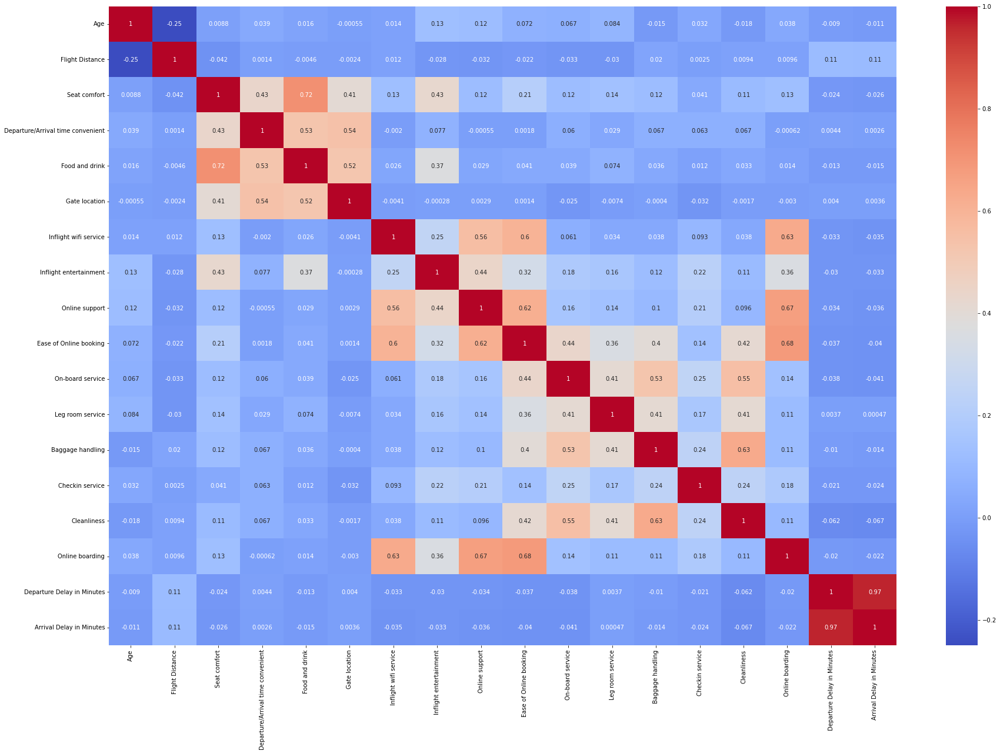

In [ ]:
plt.figure(figsize=(30,20))
sns.heatmap(df.corr(),annot=True,cmap='coolwarm')
plt.tight_layout
plt.show()

In [ ]:
df.nunique()

satisfaction                            2
Gender                                  2
Customer Type                           2
Age                                    75
Type of Travel                          2
Class                                   3
Flight Distance                      5398
Seat comfort                            6
Departure/Arrival time convenient       6
Food and drink                          6
Gate location                           6
Inflight wifi service                   6
Inflight entertainment                  6
Online support                          6
Ease of Online booking                  6
On-board service                        6
Leg room service                        6
Baggage handling                        5
Checkin service                         6
Cleanliness                             6
Online boarding                         6
Departure Delay in Minutes            466
Arrival Delay in Minutes              472
dtype: int64

In [ ]:
corr_df = (df.corr().where(np.triu(np.ones(df.corr().shape), k=1)
                                     .astype(np.bool)).stack().sort_values(ascending=False))
corr_df

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  


Departure Delay in Minutes  Arrival Delay in Minutes      0.965291
Seat comfort                Food and drink                0.715997
Ease of Online booking      Online boarding               0.684320
Online support              Online boarding               0.669843
Baggage handling            Cleanliness                   0.631803
                                                            ...   
On-board service            Arrival Delay in Minutes     -0.041456
Flight Distance             Seat comfort                 -0.042409
Cleanliness                 Departure Delay in Minutes   -0.062134
                            Arrival Delay in Minutes     -0.067208
Age                         Flight Distance              -0.249625
Length: 153, dtype: float64

**the** correlation between 'Arrival Delay in Minutes' and 'Departure Delay in 



Minutes' is 96.529

```
Departure Delay in Minutes  Arrival Delay in Minutes      0.965291
```


Therefore only one column can be relied upon so that we can remove the column with the missing values without high impact on the data


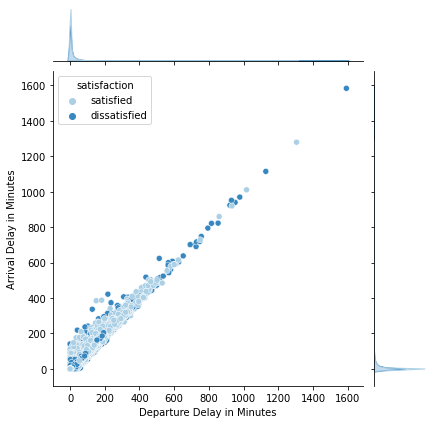

In [ ]:
sns.jointplot(x='Departure Delay in Minutes', 
              y='Arrival Delay in Minutes', 
              data = df, hue = 'satisfaction',
              palette="Blues")
plt.show()

delete the column

In [ ]:
df.drop('Arrival Delay in Minutes', axis=1, inplace=True)

In [ ]:
df.head()

,satisfaction,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Seat comfort,Departure/Arrival time convenient,Food and drink,Gate location,Inflight wifi service,Inflight entertainment,Online support,Ease of Online booking,On-board service,Leg room service,Baggage handling,Checkin service,Cleanliness,Online boarding,Departure Delay in Minutes
0,satisfied,Female,Loyal Customer,65,Personal Travel,Eco,265,0,0,0,2,2,4,2,3,3,0,3,5,3,2,0
1,satisfied,Male,Loyal Customer,47,Personal Travel,Business,2464,0,0,0,3,0,2,2,3,4,4,4,2,3,2,310
2,satisfied,Female,Loyal Customer,15,Personal Travel,Eco,2138,0,0,0,3,2,0,2,2,3,3,4,4,4,2,0
3,satisfied,Female,Loyal Customer,60,Personal Travel,Eco,623,0,0,0,3,3,4,3,1,1,0,1,4,1,3,0
4,satisfied,Female,Loyal Customer,70,Personal Travel,Eco,354,0,0,0,3,4,3,4,2,2,0,2,4,2,5,0


In [ ]:
df.isnull().sum() 

satisfaction                         0
Gender                               0
Customer Type                        0
Age                                  0
Type of Travel                       0
Class                                0
Flight Distance                      0
Seat comfort                         0
Departure/Arrival time convenient    0
Food and drink                       0
Gate location                        0
Inflight wifi service                0
Inflight entertainment               0
Online support                       0
Ease of Online booking               0
On-board service                     0
Leg room service                     0
Baggage handling                     0
Checkin service                      0
Cleanliness                          0
Online boarding                      0
Departure Delay in Minutes           0
dtype: int64

In [ ]:
df.to_csv('/gdrive/MyDrive/Colab Notebooks/Invistico_Airline_clean.csv')

In [ ]:
df_clean = pd.read_csv("/gdrive/MyDrive/Colab Notebooks/Invistico_Airline_clean.csv")
df_clean.head()

,Unnamed: 0,satisfaction,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Seat comfort,Departure/Arrival time convenient,Food and drink,Gate location,Inflight wifi service,Inflight entertainment,Online support,Ease of Online booking,On-board service,Leg room service,Baggage handling,Checkin service,Cleanliness,Online boarding,Departure Delay in Minutes
0,0,satisfied,Female,Loyal Customer,65,Personal Travel,Eco,265,0,0,0,2,2,4,2,3,3,0,3,5,3,2,0
1,1,satisfied,Male,Loyal Customer,47,Personal Travel,Business,2464,0,0,0,3,0,2,2,3,4,4,4,2,3,2,310
2,2,satisfied,Female,Loyal Customer,15,Personal Travel,Eco,2138,0,0,0,3,2,0,2,2,3,3,4,4,4,2,0
3,3,satisfied,Female,Loyal Customer,60,Personal Travel,Eco,623,0,0,0,3,3,4,3,1,1,0,1,4,1,3,0
4,4,satisfied,Female,Loyal Customer,70,Personal Travel,Eco,354,0,0,0,3,4,3,4,2,2,0,2,4,2,5,0


In [ ]:
Class_type = CategoricalDtype(categories=["Business", "Eco Plus", "Eco" ] ,ordered=True)
df['Class_ord']= df.Class.astype(Class_type).cat.codes

satisfaction_type = CategoricalDtype(categories=["satisfied", "dissatisfied"], ordered=False)
df['satisfaction_bin']= df.satisfaction.astype(satisfaction_type).cat.codes

Gender_type = CategoricalDtype(categories=["Female", "Male"], ordered=False)
df['Gender_bin']= df["Gender"].astype(Gender_type).cat.codes

Customer_Type_bin = CategoricalDtype(categories=["Loyal Customer", "disloyal Customer"], ordered=False)
df['Customer_Type_bin']= df["Customer Type"].astype(Customer_Type_bin).cat.codes

Type_of_Travel_type = CategoricalDtype(categories=["Personal Travel", "Business travel"], ordered=False)
df['Type_of_Travel_bin']= df["Type of Travel"].astype(Type_of_Travel_type).cat.codes

df.head()

,satisfaction,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Seat comfort,Departure/Arrival time convenient,Food and drink,Gate location,Inflight wifi service,Inflight entertainment,Online support,Ease of Online booking,On-board service,Leg room service,Baggage handling,Checkin service,Cleanliness,Online boarding,Departure Delay in Minutes,Class_ord,satisfaction_bin,Gender_bin,Customer_Type_bin,Type_of_Travel_bin
0,satisfied,Female,Loyal Customer,65,Personal Travel,Eco,265,0,0,0,2,2,4,2,3,3,0,3,5,3,2,0,2,0,0,0,0
1,satisfied,Male,Loyal Customer,47,Personal Travel,Business,2464,0,0,0,3,0,2,2,3,4,4,4,2,3,2,310,0,0,1,0,0
2,satisfied,Female,Loyal Customer,15,Personal Travel,Eco,2138,0,0,0,3,2,0,2,2,3,3,4,4,4,2,0,2,0,0,0,0
3,satisfied,Female,Loyal Customer,60,Personal Travel,Eco,623,0,0,0,3,3,4,3,1,1,0,1,4,1,3,0,2,0,0,0,0
4,satisfied,Female,Loyal Customer,70,Personal Travel,Eco,354,0,0,0,3,4,3,4,2,2,0,2,4,2,5,0,2,0,0,0,0


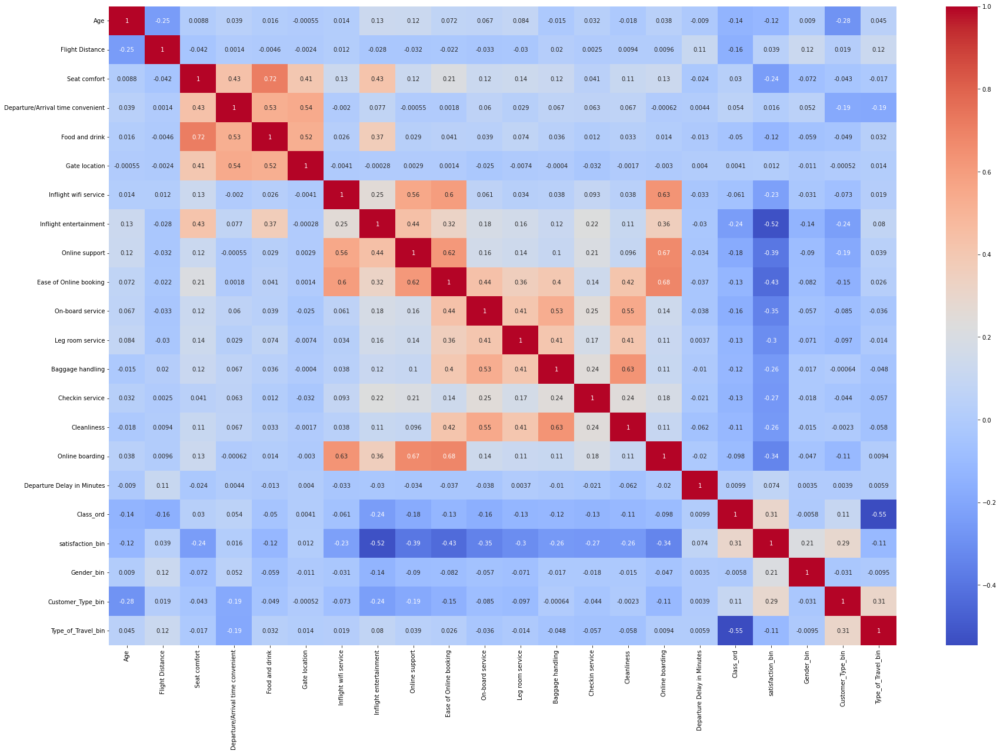

In [ ]:
plt.figure(figsize=(30,20))
sns.heatmap(df.corr(), annot=True, cmap='coolwarm')
plt.tight_layout
plt.show()

# **Exploratory Data Analysis**


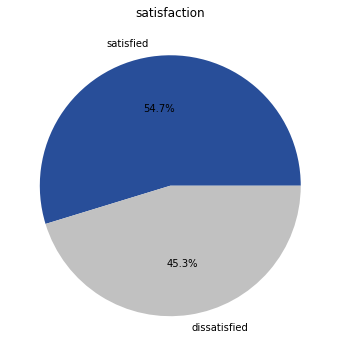

In [ ]:
fig, ax = plt.subplots(figsize=(10, 6))
colors = ["#284e99","#c1c1c1"]
labels = df_clean["satisfaction"].value_counts().index.tolist()
ax.pie(df_clean["satisfaction"].value_counts(), colors=colors, labels=labels, autopct='%.1f%%')
ax.set_title('satisfaction')
plt.show()


In [ ]:
df_clean['satisfaction'] = df_clean['satisfaction'].map({'satisfied': 1,'dissatisfied': 0})
df_clean['Gender'] = df_clean['Gender'].map({'Female': 1,'Male': 0})
df_clean['Customer Type'] = df_clean['Customer Type'].map({'Loyal Customer': 1,'disloyal Customer': 0})
df_clean['Type of Travel'] = df_clean['Type of Travel'].map({'Personal Travel': 1,'Business travel': 0})
df_clean['Class'] = df_clean['Class'].map({'Business': 1,'Eco Plus': 2,'Eco': 3})
df_clean.head()

,Unnamed: 0,satisfaction,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Seat comfort,Departure/Arrival time convenient,Food and drink,Gate location,Inflight wifi service,Inflight entertainment,Online support,Ease of Online booking,On-board service,Leg room service,Baggage handling,Checkin service,Cleanliness,Online boarding,Departure Delay in Minutes
0,0,1,1,1,65,1,3,265,0,0,0,2,2,4,2,3,3,0,3,5,3,2,0
1,1,1,0,1,47,1,1,2464,0,0,0,3,0,2,2,3,4,4,4,2,3,2,310
2,2,1,1,1,15,1,3,2138,0,0,0,3,2,0,2,2,3,3,4,4,4,2,0
3,3,1,1,1,60,1,3,623,0,0,0,3,3,4,3,1,1,0,1,4,1,3,0
4,4,1,1,1,70,1,3,354,0,0,0,3,4,3,4,2,2,0,2,4,2,5,0


Correlation with Satisfaction By features

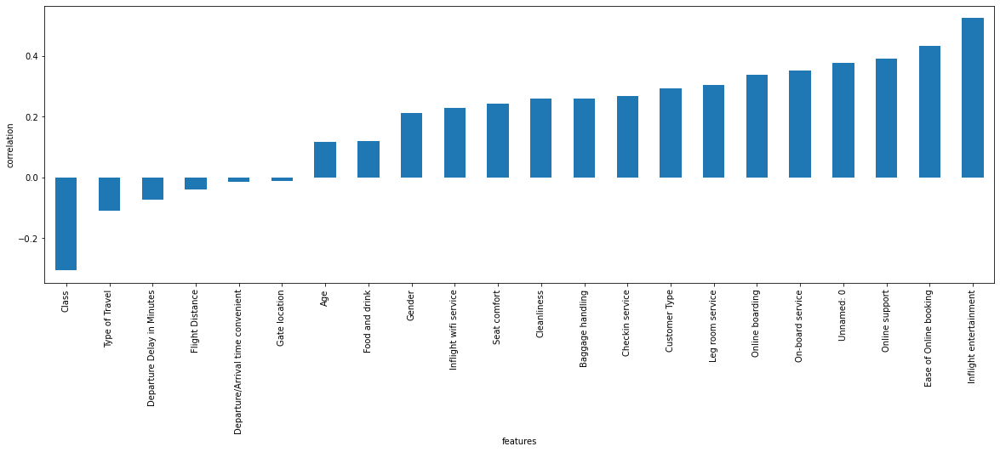

In [ ]:
plt.figure(figsize = (20,6))
df_clean.corr()['satisfaction'].sort_values().drop('satisfaction').plot(kind='bar')
plt.xlabel('features')
plt.ylabel('correlation')
plt.show()

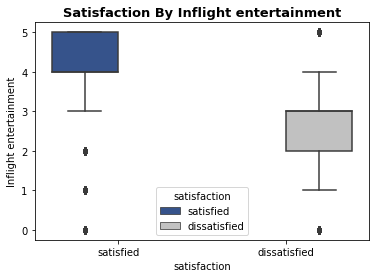

In [ ]:
sns.boxplot(y='Inflight entertainment', x='satisfaction', hue="satisfaction",
                       palette=["#284e99","#c1c1c1"], data=df)
plt.title("Satisfaction By Inflight entertainment", fontsize = 13, weight = 'bold')
plt.show()

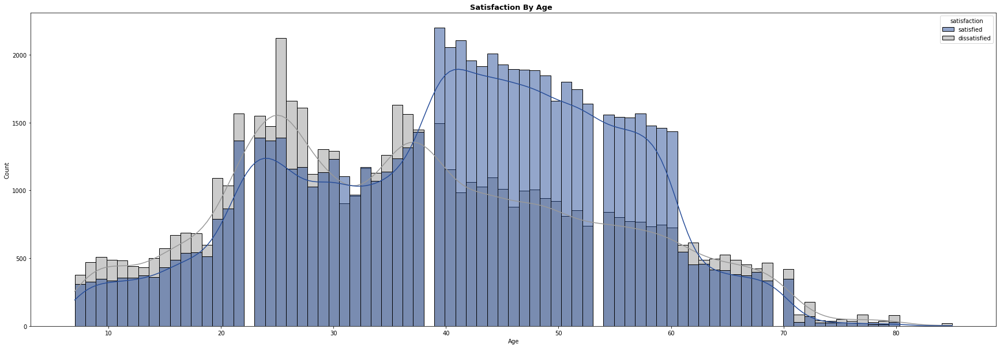

In [ ]:
plt.subplots(figsize=(30,10))
sns.histplot(x='Age', hue="satisfaction", data=df ,kde=True 
             ,palette=["#284e99","#999999"])
plt.title("Satisfaction By Age  ", fontsize = 13, weight = 'bold')

plt.show()

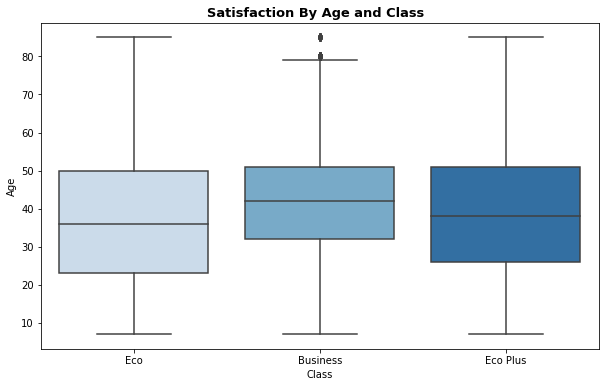

In [ ]:
plt.subplots(figsize=(10, 6))
sns.boxplot(x='Class',
            y='Age', data=df, palette='Blues')
plt.title("Satisfaction By Age and Class  ", fontsize = 13, weight = 'bold')

plt.show()

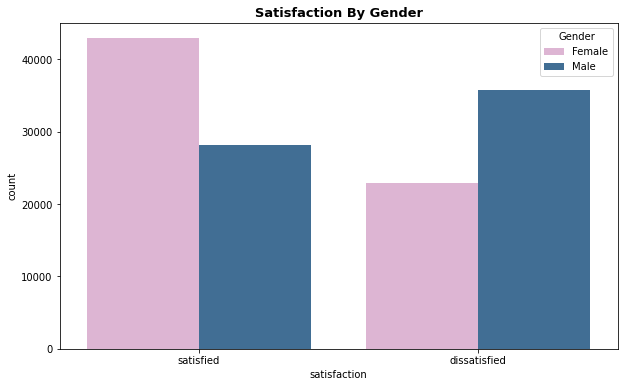

In [ ]:
fig, ax = plt.subplots(figsize=(10, 6))
plt.title("Satisfaction By Gender", fontsize = 13, weight = 'bold')
sns.countplot(x = 'satisfaction', hue = 'Gender', palette=["#e3afd6", "#336FA2"], data = df) 
plt.show()

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


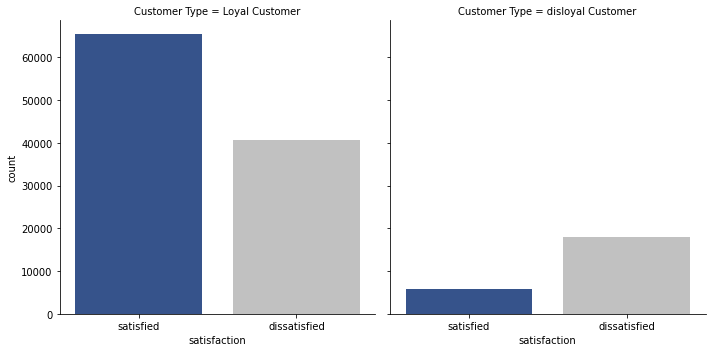

In [ ]:
sns.catplot("satisfaction", col="Customer Type", col_wrap=2, data=df, 
            palette=["#284e99","#c1c1c1"], kind="count")

plt.show()

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


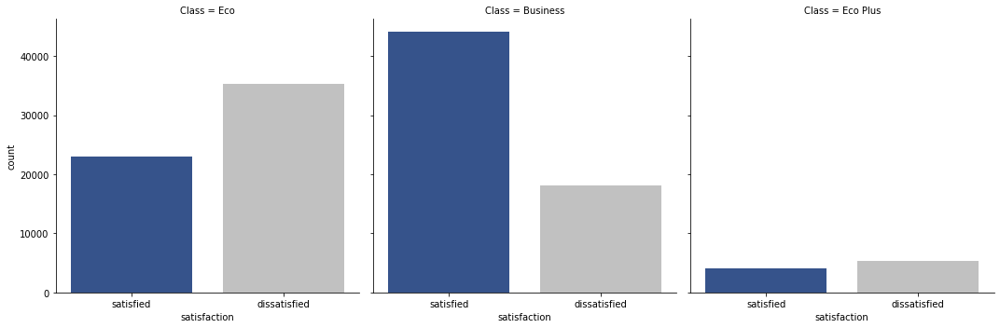

In [ ]:
sns.catplot("satisfaction", col="Class", col_wrap=3, data=df, 
            palette=["#284e99","#c1c1c1"], kind="count")

plt.show()

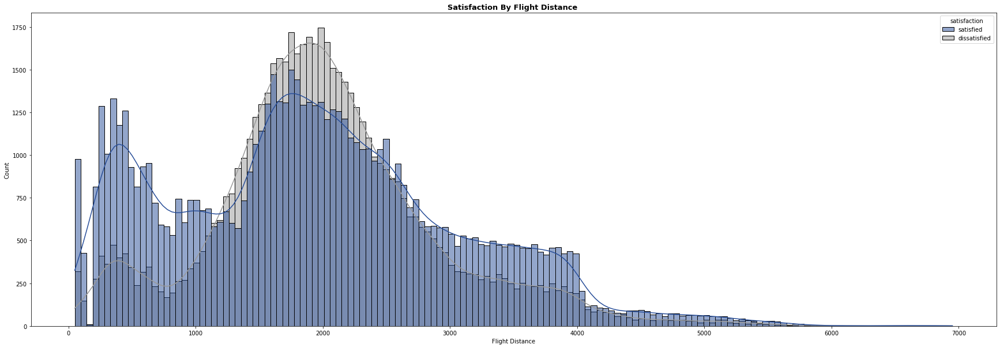

In [ ]:
plt.subplots(figsize=(30,10))
sns.histplot(x='Flight Distance', hue="satisfaction", data=df ,kde=True,
             palette=["#284e99","#999999"])
plt.title("Satisfaction By Flight Distance ", fontsize = 13, weight = 'bold')
plt.show()

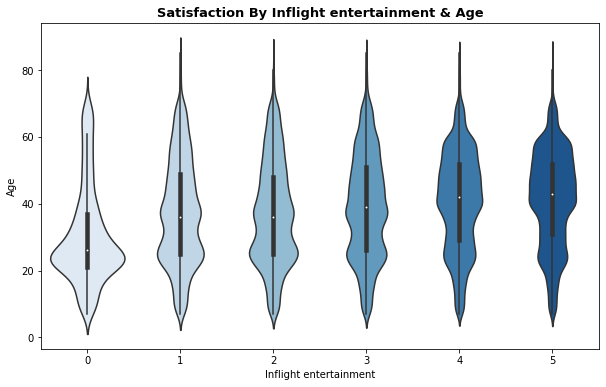

In [ ]:
plt.subplots(figsize=(10, 6))
sns.violinplot(x='Inflight entertainment', y='Age', data=df, palette='Blues')
plt.title("Satisfaction By Inflight entertainment & Age", fontsize = 13, weight = 'bold')

plt.show()

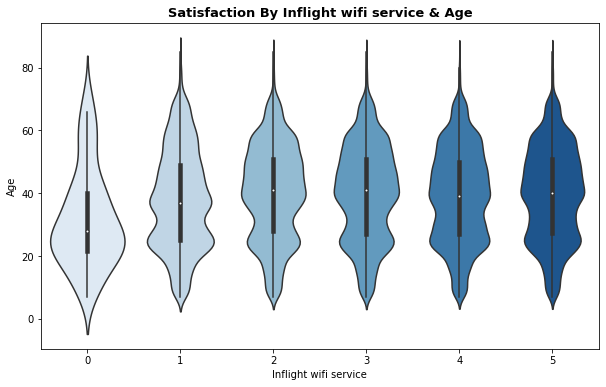

In [ ]:
plt.subplots(figsize=(10, 6))
sns.violinplot(x='Inflight wifi service', y='Age', data=df, palette='Blues')
plt.title("Satisfaction By Inflight wifi service & Age", fontsize = 13, weight = 'bold')

plt.show()

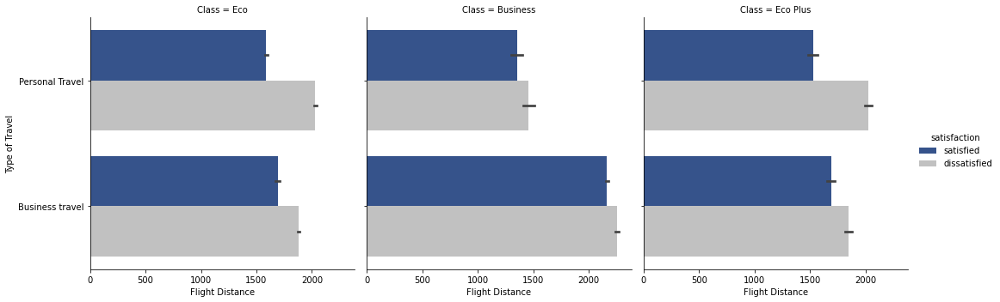

In [ ]:
sns.catplot(x="Flight Distance", y="Type of Travel", hue="satisfaction", 
            col="Class", data=df ,palette=["#284e99","#c1c1c1"], kind="bar")

plt.show()

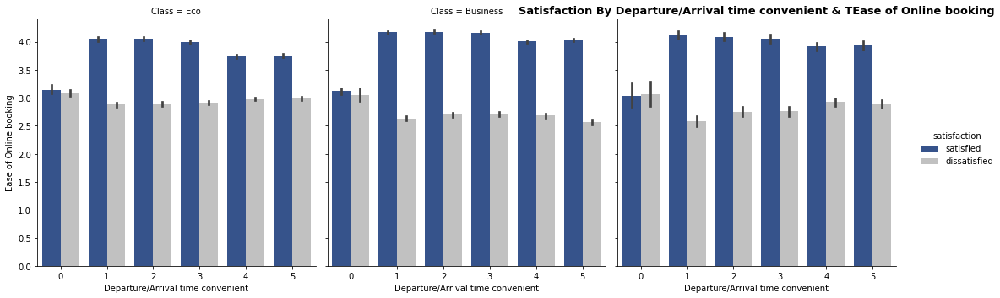

In [ ]:
sns.catplot(x="Departure/Arrival time convenient", y="Ease of Online booking", 
            hue="satisfaction", col="Class", data=df, kind='bar' ,palette=["#284e99","#c1c1c1"])
plt.title("Satisfaction By Departure/Arrival time convenient & TEase of Online booking", fontsize = 13, weight = 'bold')

plt.show()

In [ ]:
df.groupby(['Gender','Class']).mean()[['Seat comfort',
                                       'Departure/Arrival time convenient', 
                                       'Food and drink',
                                       'Gate location',
                                       'Inflight wifi service',
                                       'Inflight entertainment',
                                       'Online support',
                                       'Ease of Online booking',
                                       'On-board service', 
                                       'Leg room service',
                                       'Baggage handling',
                                       'Checkin service',
                                       'Cleanliness',
                                       'Online boarding']].round(decimals=2)

Seat comfort  ...  Online boarding
Gender Class                   ...                 
Female Business          2.80  ...             3.49
       Eco               3.06  ...             3.35
       Eco Plus          3.08  ...             3.30
Male   Business          2.78  ...             3.49
       Eco               2.69  ...             3.10
       Eco Plus          2.78  ...             3.13

[6 rows x 14 columns]

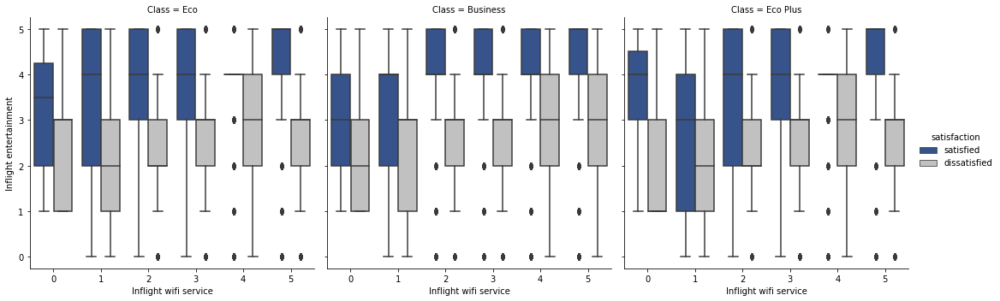

In [ ]:
sns.catplot(x="Inflight wifi service", y="Inflight entertainment",
            hue="satisfaction", col="Class",palette=["#284e99","#c1c1c1"], 
            data=df, kind="box")

plt.show()

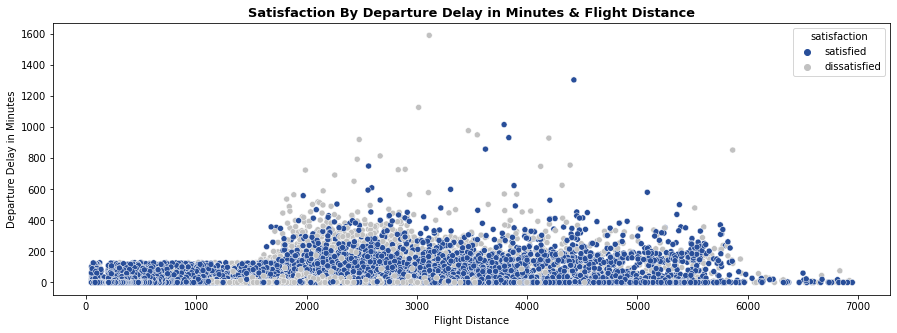

In [ ]:
plt.subplots(figsize=(15,5))
sns.scatterplot(x= df['Flight Distance'], 
                y= df['Departure Delay in Minutes'], 
                hue= df['satisfaction'], 
                palette=["#284e99","#c1c1c1"])
plt.title("Satisfaction By Departure Delay in Minutes & Flight Distance", fontsize = 13, weight = 'bold')

plt.show()

# **Classification Model**

In [ ]:
df_base = pd.read_csv("/gdrive/MyDrive/Colab Notebooks/Invistico_Airline.csv")
df_base['satisfaction'] = df_base['satisfaction'].map({'satisfied': 1,'dissatisfied': 0})
df_base['Gender'] = df_base['Gender'].map({'Female': 1,'Male': 0})
df_base['Customer Type'] = df_base['Customer Type'].map({'Loyal Customer': 1,'disloyal Customer': 0})
df_base['Type of Travel'] = df_base['Type of Travel'].map({'Personal Travel': 1,'Business travel': 0})
df_base['Class'] = df_base['Class'].map({'Business': 1,'Eco Plus': 2,'Eco': 3})

In [ ]:
X = df_clean.drop('satisfaction',axis=1)
y = df_clean['satisfaction']
X_train, X_test, y_train, y_test = train_test_split(X, y, 
                                                    train_size=0.7,
                                                    random_state=1)



####**Gaussian Naïve Bayes**

In [ ]:
model = GaussianNB()
max_accuracy=0
f1, f2 = X.columns[0], X.columns[1]
for col1 in X.columns:
    for col2 in X.columns:
        if col1 != col2:
            model.fit(X_train[[col1, col2]], y_train)
            y_pred= model.predict(X_test[[col1, col2]])
            accuracy = accuracy_score(y_test, y_pred)
            if accuracy > max_accuracy:
                f1, f2, max_accuracy = col1, col2, accuracy 
print(f"The 2 features With a best results for a Gaussian Naïve Bayes classifier: {f1}, {f2}")
print(f"The Accuracy is {round(max_accuracy*100, 6)}%")

The 2 features With a best results for a Gaussian Naïve Bayes classifier: Seat comfort, Inflight entertainment
The Accuracy is 82.188687%


In [ ]:
X = df[['Seat comfort', 'Inflight entertainment']]
Y = df['satisfaction']
def bayes_plot(df, model="gnb", spread=30):
    df.dropna()
    colors = 'Blues'
    col1 = df.columns[0]
    col2 = df.columns[1]
    target = df.columns[2]
    sns.scatterplot(data=df, x=col1, y=col2,hue=target,palette=colors)
    plt.show()

    y = df[target]  # Target variable
    X = df.drop(target, axis=1)

    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3,random_state=1)  # 70% training and 30% test

    clf = GaussianNB()
    if (model != "gnb"):
        clf = DecisionTreeClassifier(max_depth=model)
    clf = clf.fit(X_train, y_train)
    
    # Train Classifer
    prob = len(clf.classes_) == 2

    # Predict the response for test dataset
    y_pred = clf.predict(X_test)
    print(metrics.classification_report(y_test, y_pred))

    hueorder = clf.classes_

    def numify(val):
        return np.where(clf.classes_ == val)[0]

    Y = y.apply(numify)
    x_min, x_max = X.loc[:, col1].min() - 1, X.loc[:, col1].max() + 1
    y_min, y_max = X.loc[:, col2].min() - 1, X.loc[:, col2].max() + 1
    xx, yy = np.meshgrid(np.arange(x_min, x_max, 0.2),
                         np.arange(y_min, y_max, 0.2))

    Z = clf.predict_proba(np.c_[xx.ravel(), yy.ravel()])
    if prob:

        Z = Z[:,1]-Z[:,0]
    else:
        colors = "PuBuGn"
        Z = np.argmax(Z, axis=1)


    # Put the result into a color plot
    Z = Z.reshape(xx.shape)
    plt.contourf(xx, yy, Z, cmap=colors, alpha=0.5)
    plt.colorbar()
    if not prob:
        plt.clim(0,len(clf.classes_)+3)
    sns.scatterplot(data=df[::spread], x=col1, y=col2, hue=target, hue_order=hueorder,palette=colors)
    fig = plt.gcf()
    fig.set_size_inches(12, 8)
    plt.show()

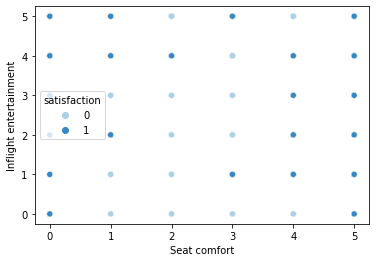

              precision    recall  f1-score   support

           0       0.84      0.75      0.79     17700
           1       0.81      0.88      0.84     21264

    accuracy                           0.82     38964
   macro avg       0.82      0.82      0.82     38964
weighted avg       0.82      0.82      0.82     38964



/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but GaussianNB was fitted with feature names
  "X does not have valid feature names, but"


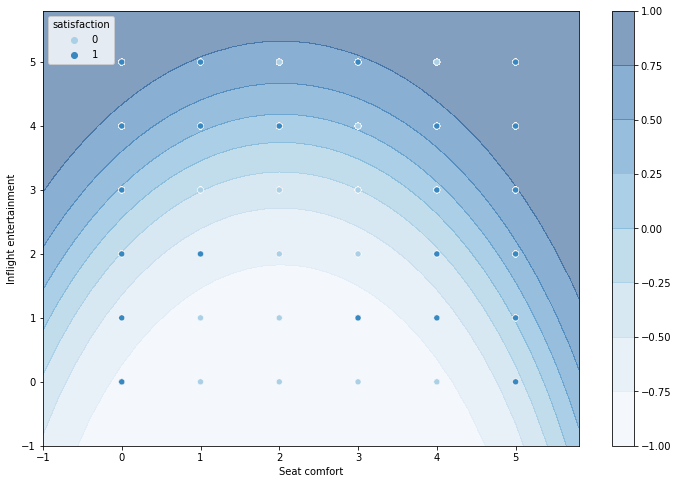

In [ ]:
bayes_plot(pd.concat([X,y],axis=1),spread=1)

####**Decision Tree**

In [ ]:
from io import StringIO
#!conda install -y python-graphviz
from IPython.display import Image
from sklearn.tree import export_graphviz
from sklearn.inspection import permutation_importance

Feature: Gender, Score: 0.09874
Feature: Customer Type, Score: 0.13245
Feature: Age, Score: 0.05243
Feature: Type of Travel, Score: 0.15366
Feature: Class, Score: 0.03532
Feature: Flight Distance, Score: 0.03952
Feature: Departure/Arrival time convenient, Score: 0.02152
Feature: Food and drink, Score: 0.11026
Feature: Gate location, Score: 0.03065
Feature: Inflight wifi service, Score: 0.02001
Feature: Online support, Score: 0.08509
Feature: Ease of Online booking, Score: 0.09381
Feature: On-board service, Score: 0.04315
Feature: Leg room service, Score: 0.05115
Feature: Baggage handling, Score: 0.05859
Feature: Checkin service, Score: 0.05722
Feature: Cleanliness, Score: 0.06322
Feature: Online boarding, Score: 0.07847
Feature: Departure Delay in Minutes, Score: 0.01950
Feature: Arrival Delay in Minutes, Score: 0.02905
20 []


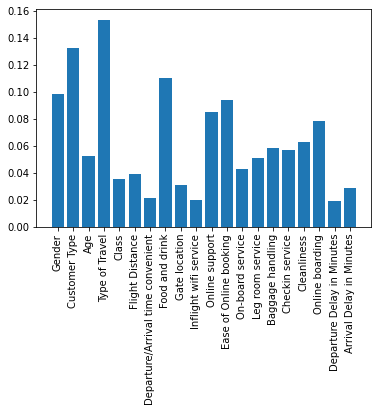

              precision    recall  f1-score   support

           0       0.90      0.90      0.90     17615
           1       0.92      0.92      0.92     21232

    accuracy                           0.91     38847
   macro avg       0.91      0.91      0.91     38847
weighted avg       0.91      0.91      0.91     38847

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.106233 to fit

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.106233 to fit



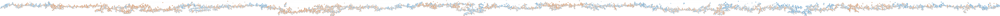

In [ ]:
df_base.dropna(inplace=True)
X = df_base.drop(['Seat comfort', 'Inflight entertainment',"satisfaction"],axis=1)
y = df_base['satisfaction']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3,random_state=1)  # 70% training and 30% test
clf = DecisionTreeClassifier()
clf.fit(X_train,y_train)

result = permutation_importance(clf, X, y, n_repeats=10,random_state=0)
importance = zip(X.columns,result['importances_mean'])
# summarize feature importance
for i,v in importance:
    print('Feature: %s, Score: %.5f' % (i,v))
# plot feature importance
print(len(X.columns),[x[1] for x in importance])
plt.bar(range(len(X.columns)), result['importances_mean'])
plt.xticks(ticks=range(len(X.columns)),labels=X.columns, rotation=90)
plt.show()

y_pred = clf.predict(X_test)

print(metrics.classification_report(y_test, y_pred))

dot_data=StringIO()
export_graphviz(clf ,out_file=dot_data ,filled=True ,rounded=True ,feature_names=X.columns)
graph=pydotplus.graph_from_dot_data(dot_data.getvalue())
graph.write_png('base.png')
Image(graph.create_png())

Feature: Unnamed: 0, Score: 0.35260
Feature: Gender, Score: 0.12875
Feature: Customer Type, Score: 0.05350
Feature: Age, Score: 0.02665
Feature: Type of Travel, Score: 0.00260
Feature: Class, Score: 0.01867
Feature: Flight Distance, Score: 0.02469
Feature: Departure/Arrival time convenient, Score: 0.00288
Feature: Food and drink, Score: 0.04113
Feature: Gate location, Score: 0.00804
Feature: Inflight wifi service, Score: 0.00795
Feature: Online support, Score: 0.06690
Feature: Ease of Online booking, Score: 0.02503
Feature: On-board service, Score: 0.02547
Feature: Leg room service, Score: 0.00668
Feature: Baggage handling, Score: 0.05870
Feature: Checkin service, Score: 0.04739
Feature: Cleanliness, Score: 0.05818
Feature: Online boarding, Score: 0.03833
Feature: Departure Delay in Minutes, Score: 0.01710
20 []


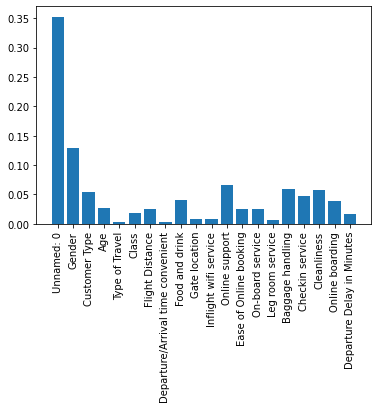

              precision    recall  f1-score   support

           0       0.93      0.93      0.93     17700
           1       0.94      0.95      0.94     21264

    accuracy                           0.94     38964
   macro avg       0.94      0.94      0.94     38964
weighted avg       0.94      0.94      0.94     38964

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.188856 to fit

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.188856 to fit



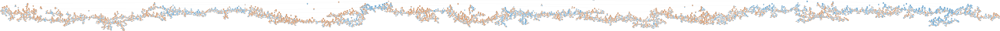

In [ ]:
df_clean.dropna(inplace=True)
X = df_clean.drop(['Seat comfort', 'Inflight entertainment',"satisfaction"],axis=1)
y = df_clean['satisfaction']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3,random_state=1)  # 70% training and 30% test
clf = DecisionTreeClassifier()
clf.fit(X_train,y_train)

result = permutation_importance(clf, X, y, n_repeats=10,random_state=0)
importance = zip(X.columns,result['importances_mean'])
# summarize feature importance
for i,v in importance:
    print('Feature: %s, Score: %.5f' % (i,v))
# plot feature importance
print(len(X.columns),[x[1] for x in importance])
plt.bar(range(len(X.columns)), result['importances_mean'])
plt.xticks(ticks=range(len(X.columns)),labels=X.columns, rotation=90)
plt.show()

y_pred = clf.predict(X_test)

print(metrics.classification_report(y_test, y_pred))

dot_data=StringIO()
export_graphviz(clf ,out_file=dot_data ,filled=True ,rounded=True ,feature_names=X.columns)
graph=pydotplus.graph_from_dot_data(dot_data.getvalue())
graph.write_png('clean.png')
Image(graph.create_png())

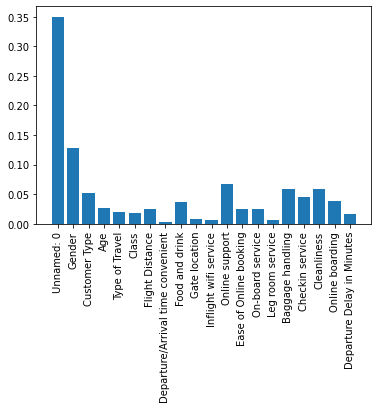

              precision    recall  f1-score   support

           0       0.93      0.93      0.93     17700
           1       0.94      0.94      0.94     21264

    accuracy                           0.94     38964
   macro avg       0.94      0.94      0.94     38964
weighted avg       0.94      0.94      0.94     38964

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.191048 to fit

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.191048 to fit



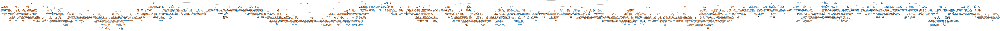

In [ ]:
df_clean.dropna(inplace=True)
X = df_clean.drop(['Seat comfort', 'Inflight entertainment',"satisfaction"],axis=1)
y = df_clean['satisfaction']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3,random_state=1)  # 70% training and 30% test
clf = DecisionTreeClassifier()
clf.fit(X_train,y_train)

result = permutation_importance(clf, X, y, n_repeats=10,random_state=0)
importance = zip(X.columns,result['importances_mean'])
# summarize feature importance
for i,v in importance:
   if i is 0:
    print('Feature: %s, Score: %.5f' % (i,v))
    # plot feature importance
    print(len(X.columns),[x[1] for x in importance])
plt.bar(range(len(X.columns)), result['importances_mean'])
plt.xticks(ticks=range(len(X.columns)),labels=X.columns, rotation=90)
plt.show()

y_pred = clf.predict(X_test)

print(metrics.classification_report(y_test, y_pred))

dot_data=StringIO()
export_graphviz(clf ,out_file=dot_data ,filled=True ,rounded=True ,feature_names=X.columns)
graph=pydotplus.graph_from_dot_data(dot_data.getvalue())
graph.write_png('manualStop.png')
Image(graph.create_png())

# **Summary**

**The results**
It can be seen that after performing the cleaning of the data the model is more successful
When I used the best features I got a result of about 94% after cleaning

**the problems**
The problems I encountered during the surgery
They during cleaning find a more effective solution for the problematic column

**Insights**
I found the best features to classify the inflight entertainment, seat comfort data set which can provide the airline with a lot of information on how to improve customer satisfaction